# PUNCH! 데이터 분석
### 0. 개요 및 목적

현대인은 운동 부족, 스트레스, 그리고 바쁜 일상으로 인해 건강한 삶을 유지하기 어려운 환경에 놓여 있다. 특히 시간과 공간의 제약, 경제적 부담, 운동에 대한 심리적 장벽 등으로 인해 규칙적인 신체 활동이 더욱 어렵게 느껴지는 것이 현실이다. 이에 따라 좁은 공간에서도 스마트폰 하나만으로 간편하게 투 운동을 즐길 수 있는 모바일 애플리케이션 PUNCH!를 개발했다. ( 개요 )

복싱 어플리케이션을 개발하기 위해서는 사용자의 주먹을 인식할 수 있는 모델을 개발해야한다. 이때 주먹 데이터 상에 일련의 패턴이 있어야 주먹을 인식할 수 있으므로 본 프로젝트의 목적은 주먹을 지를 때 측정된 가속도 센서의 값이 어떠한 패턴을 가지는 지 찾아내는 것이다. 만약 분석을 통해 데이터끼리 유사성이 있다고 판단된다면 인공지능 모델을 개발할 때 그 패턴을 인식할 수 있도록 학습할 것이다. ( 목적 )


### 1. 주제 설명

본 프로젝트는 사용자의 주먹 동작을 인식하는 인공지능 모델 학습에 필요한 데이터를 수집 및 구축할 예정이며, 수집된 데이터는 3×T 형태(x, y, z의 축 방향으로 T개의 시간 간격을 포함)로 구성된다. 각 축의 값은 중력 가속도 성분이 제거된 순수한 동작 기반 가속도 값으로, 주먹 동작의 본질적인 움직임을 반영한다. 인식할 주먹 동작은 스트레이트, 훅, 어퍼컷, 바디 총 4가지이다. 이후, 시간에 따른 각 축의 가속도 변화 패턴을 분석하고, 주어진 주먹 데이터 부근 10개의 데이터를 가져와 각 주먹마다 패턴을 분석한다.

### 2. 데이터 수집 방법

React Native 어플리케이션을 개발하여 센서를 활성화 시켰을 때 가속도 센서, 자이로 센서, 계산된 휴대폰 위상, 중력 가속도를 제거한 순수 가속도 센서 데이터, 자력 센서, 시간 데이터를 사용자가 요구한 시간만큼 측정한 후, CSV 데이터로 저장한다. 이때 휴대폰 가속도 센서와 자이로 센서로 회전행렬을 통해 휴대폰의 위상을 측정하고, 측정된 위상으로 다시 중력 성분을 계산하여 가속도 센서 데이터에서 제거한다.

[Github](https://github.com/punch-boxing) 참고

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

datas = []

for i in range(14):
  datas.append(pd.read_csv(f"{i+1}.csv"))

### 3. 데이터 설명

* Index : 데이터 번호
* Time : 데이터 측정 시간 (0번 인덱스를 0초로한 상대시간)
* Acceleration X, Y, Z : 중력 가속도를 제거한 순수 가속도 값
* Orientation X, Z : 휴대폰의 절대위상(라디안 값)을 sin 함수에 대입한 값
* Punch Type : 사용자가 수행한 펀치 종류 (각 데이터마다 존재함)
* Raw Acceleration X, Y, Z : 중력 가속도를 제거하지 않은 가속도 값

In [ ]:
datas[0]

,Index,Time,Acceleration X,Acceleration Y,Acceleration Z,Orientation X,Orientation Z,Punch Type,Raw Acceleration X,Raw Acceleration Y,Raw Acceleration Z
0,0,0.000,-0.695800,-0.171996,-0.336659,-0.890514,-0.290511,NaN,-0.405289,-0.607330,-1.188766
1,1,0.050,-0.003524,-0.013142,-0.019120,-0.824100,0.150148,NaN,-0.153671,-0.573166,-0.833878
2,2,0.100,0.012226,0.034453,0.038079,-0.741530,0.231601,NaN,-0.219376,-0.618225,-0.683289
3,3,0.150,0.033156,0.205395,0.135430,-0.550472,0.133559,NaN,-0.100403,-0.621979,-0.410110
4,4,0.199,-0.011023,0.183771,0.154291,-0.643006,-0.045889,NaN,0.034866,-0.581284,-0.488037
...,...,...,...,...,...,...,...,...,...,...,...
840,840,50.150,-0.002344,-0.021693,-0.036634,-0.860451,0.054983,NaN,-0.057327,-0.530457,-0.895782
841,841,50.200,0.002128,0.020523,0.032565,-0.846004,0.055198,NaN,-0.053070,-0.511841,-0.812149
842,842,50.250,-0.002483,-0.007863,-0.010538,-0.801489,0.185536,NaN,-0.188019,-0.595490,-0.798111
843,843,50.300,0.000147,0.000497,0.000622,-0.781390,0.181696,NaN,-0.181549,-0.613159,-0.767761


In [ ]:
datas[1]

,Index,Time,Acceleration X,Acceleration Y,Acceleration Z,Orientation X,Orientation Z,Punch Type,Raw Acceleration X,Raw Acceleration Y,Raw Acceleration Z
0,0,0.000,0.309145,-0.044909,-0.023828,-0.468692,0.150698,NaN,0.158447,-0.918182,-0.487167
1,1,0.050,0.006596,-0.034448,-0.017709,-0.457194,-0.167873,NaN,0.174469,-0.911194,-0.468414
2,2,0.100,0.002884,-0.018504,-0.010030,-0.476528,-0.135742,NaN,0.138626,-0.889526,-0.482147
3,3,0.150,-0.011540,0.046244,0.024187,-0.463464,-0.215917,NaN,0.204376,-0.818970,-0.428345
4,4,0.200,-0.024722,0.083861,0.039675,-0.427662,-0.257495,NaN,0.232773,-0.789597,-0.373566
...,...,...,...,...,...,...,...,...,...,...,...
650,650,39.591,0.011840,-0.041064,-0.042015,-0.715152,-0.197557,NaN,0.209396,-0.726257,-0.743073
651,651,39.641,-0.003020,0.025308,0.023191,-0.675602,-0.087645,NaN,0.084625,-0.709122,-0.649811
652,652,39.691,0.002446,-0.016846,-0.013714,-0.631332,-0.111873,NaN,0.114319,-0.787491,-0.641083
653,653,39.740,0.002850,-0.035619,-0.031692,-0.664729,-0.059680,NaN,0.062531,-0.781372,-0.695236


In [ ]:
for i in datas:
  i.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 845 entries, 0 to 844
Data columns (total 11 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Index               845 non-null    int64  
 1   Time                845 non-null    float64
 2   Acceleration X      845 non-null    float64
 3   Acceleration Y      845 non-null    float64
 4   Acceleration Z      845 non-null    float64
 5   Orientation X       845 non-null    float64
 6   Orientation Z       845 non-null    float64
 7   Punch Type          30 non-null     object 
 8   Raw Acceleration X  845 non-null    float64
 9   Raw Acceleration Y  845 non-null    float64
 10  Raw Acceleration Z  845 non-null    float64
dtypes: float64(9), int64(1), object(1)
memory usage: 72.7+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 655 entries, 0 to 654
Data columns (total 11 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  

### 4. 데이터 전처리

데이터 준비할 떄 모든 결측치 및 이상치를 이미 제거했다. ( Punch Type 은 특정 펀치 피크(peak) 빼고는 None 값이 올바름 )

In [ ]:
for i in datas:
  print(i.isnull().sum())

Index                   0
Time                    0
Acceleration X          0
Acceleration Y          0
Acceleration Z          0
Orientation X           0
Orientation Z           0
Punch Type            815
Raw Acceleration X      0
Raw Acceleration Y      0
Raw Acceleration Z      0
dtype: int64
Index                   0
Time                    0
Acceleration X          0
Acceleration Y          0
Acceleration Z          0
Orientation X           0
Orientation Z           0
Punch Type            623
Raw Acceleration X      0
Raw Acceleration Y      0
Raw Acceleration Z      0
dtype: int64
Index                   0
Time                    0
Acceleration X          0
Acceleration Y          0
Acceleration Z          0
Orientation X           0
Orientation Z           0
Punch Type            762
Raw Acceleration X      0
Raw Acceleration Y      0
Raw Acceleration Z      0
dtype: int64
Index                   0
Time                    0
Acceleration X          0
Acceleration Y          0

이제 정규화를 진행하겠다.

In [ ]:
from sklearn.preprocessing import MinMaxScaler

numerical_cols = []
for df in datas:
    for col in df.select_dtypes(include=np.number).columns:
        if col not in ['Index', 'Time', 'Orientation X', 'Orientation Z', 'Punch Type'] and col not in numerical_cols:
            numerical_cols.append(col)

scaler = MinMaxScaler()

normalized_datas = []
for df in datas:
    df_copy = df.copy()
    cols_to_normalize = [col for col in numerical_cols if col in df_copy.columns]
    if cols_to_normalize:
        df_copy[cols_to_normalize] = scaler.fit_transform(df_copy[cols_to_normalize])
    normalized_datas.append(df_copy)

### 5. 데이터 조작

인식된 펀치( Punch Type != Null )의 앞뒤 부근 10(=0.05s * 10 = 0.5s)개의 데이터를 추출한 데이터 프레임을 만든다.

In [ ]:
punch_datas = {'Straight': [], 'Hook': [], 'UpperCut': [], 'Body': []}
normalized_punch_datas = {'Straight': [], 'Hook': [], 'UpperCut': [], 'Body': []}

for df in datas:
  punch_indices = df[df['Punch Type'].notna()].index
  for idx in punch_indices:
    start_idx = max(0, idx - 10)
    end_idx = min(len(df) - 1, idx + 10)
    punch_type = df.loc[idx, 'Punch Type']
    if punch_type in punch_datas:
      punch_datas[punch_type].append(df.iloc[start_idx:end_idx+1].reset_index(drop=True))

for df in normalized_datas:
  punch_indices = df[df['Punch Type'].notna()].index
  for idx in punch_indices:
    start_idx = max(0, idx - 10)
    end_idx = min(len(df) - 1, idx + 10)
    punch_type = df.loc[idx, 'Punch Type']
    if punch_type in punch_datas:
      normalized_punch_datas[punch_type].append(df.iloc[start_idx:end_idx+1].reset_index(drop=True))

len(punch_datas['Straight']), len(punch_datas['Hook']), len(punch_datas['UpperCut']), len(punch_datas['Body'])

(217, 118, 51, 53)

### 6. 데이터 통계 확인

아래는 최종적으로 산출한 정규화하지 않은 데이터와 정규화한 데이터이다.

In [ ]:
datas[0].describe()

,Index,Time,Acceleration X,Acceleration Y,Acceleration Z,Orientation X,Orientation Z,Raw Acceleration X,Raw Acceleration Y,Raw Acceleration Z
count,845.000000,845.000000,845.000000,845.000000,845.000000,845.000000,845.000000,845.000000,845.000000,845.000000
mean,422.000000,25.231901,-0.144520,0.043161,-0.019732,-0.341688,-0.197147,0.052628,-0.642904,-0.338402
std,244.074784,14.407022,0.837466,0.558873,0.664514,0.480119,0.392608,0.870773,0.563454,0.742279
min,0.000000,0.000000,-8.787977,-2.528672,-7.875435,-0.997518,-0.999053,-8.100113,-3.307800,-7.587204
25%,211.000000,13.058000,-0.169665,-0.103038,-0.194586,-0.718413,-0.480455,-0.178665,-0.849228,-0.767761
50%,422.000000,25.319000,-0.002593,0.013120,-0.003539,-0.525722,-0.172395,0.100311,-0.696930,-0.525970
75%,633.000000,37.261000,0.039477,0.204682,0.122800,0.034725,0.079861,0.427322,-0.486710,0.122269
max,844.000000,50.349000,4.312394,4.129272,2.475105,0.938685,0.928670,4.869370,3.204224,2.397766


In [ ]:
normalized_datas[0].describe()

,Index,Time,Acceleration X,Acceleration Y,Acceleration Z,Orientation X,Orientation Z,Raw Acceleration X,Raw Acceleration Y,Raw Acceleration Z
count,845.000000,845.000000,845.000000,845.000000,845.000000,845.000000,845.000000,845.000000,845.000000,845.000000
mean,422.000000,25.231901,0.659787,0.386280,0.758966,-0.341688,-0.197147,0.628610,0.409227,0.725971
std,244.074784,14.407022,0.063927,0.083941,0.064201,0.480119,0.392608,0.067140,0.086525,0.074340
min,0.000000,0.000000,0.000000,0.000000,0.000000,-0.997518,-0.999053,0.000000,0.000000,0.000000
25%,211.000000,13.058000,0.657868,0.364322,0.742072,-0.718413,-0.480455,0.610776,0.377544,0.682971
50%,422.000000,25.319000,0.670621,0.381768,0.760530,-0.525722,-0.172395,0.632286,0.400931,0.707186
75%,633.000000,37.261000,0.673832,0.410540,0.772736,0.034725,0.079861,0.657500,0.433213,0.772108
max,844.000000,50.349000,1.000000,1.000000,1.000000,0.938685,0.928670,1.000000,1.000000,1.000000


### 7. 데이터 시각화

각 주먹에 따른 가속도 값을 시각화 한다.

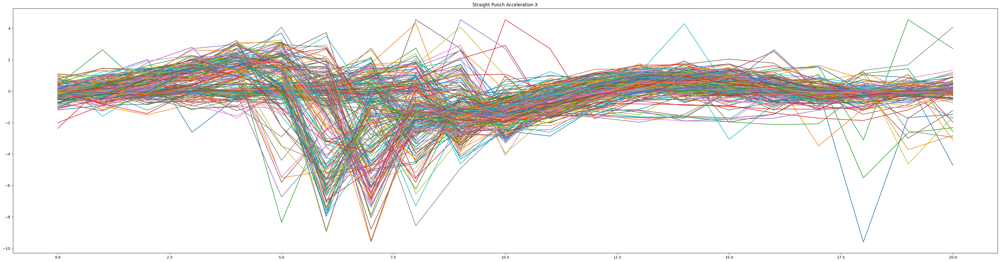

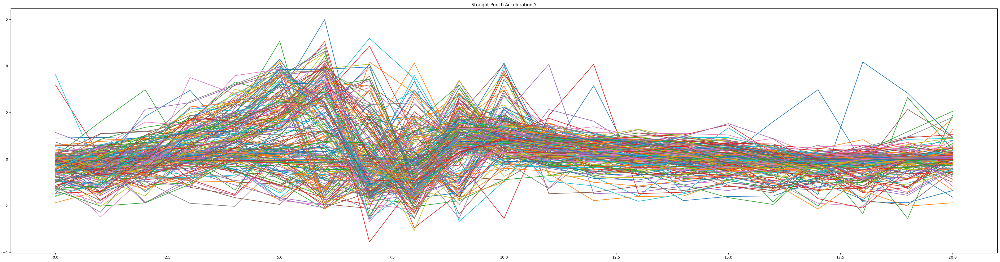

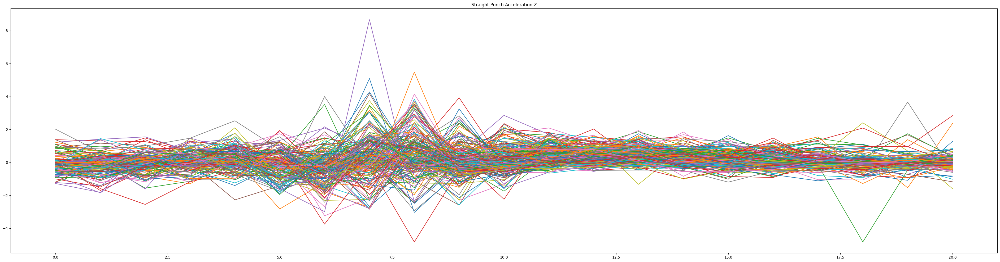

In [ ]:
plt.figure(figsize=(48, 12))
plt.title('Straight Punch Acceleration X')
for i in punch_datas['Straight']:
  plt.plot(i.index, i['Acceleration X'])

plt.figure(figsize=(48, 12))
plt.title('Straight Punch Acceleration Y')
for i in punch_datas['Straight']:
  plt.plot(i.index, i['Acceleration Y'])

plt.figure(figsize=(48, 12))
plt.title('Straight Punch Acceleration Z')
for i in punch_datas['Straight']:
  plt.plot(i.index, i['Acceleration Z'])

plt.show()

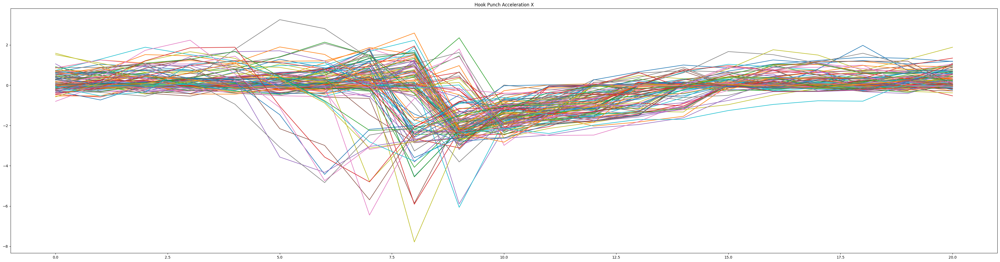

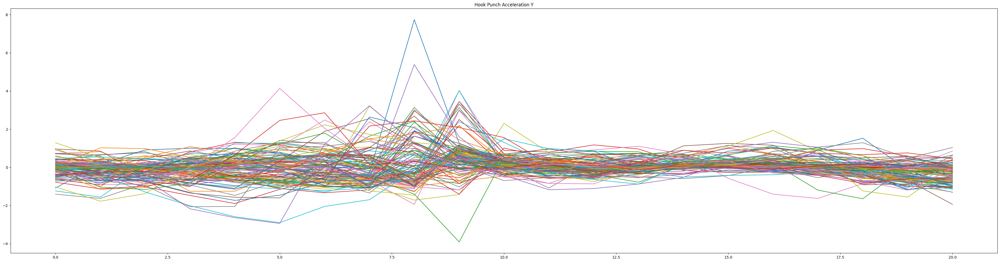

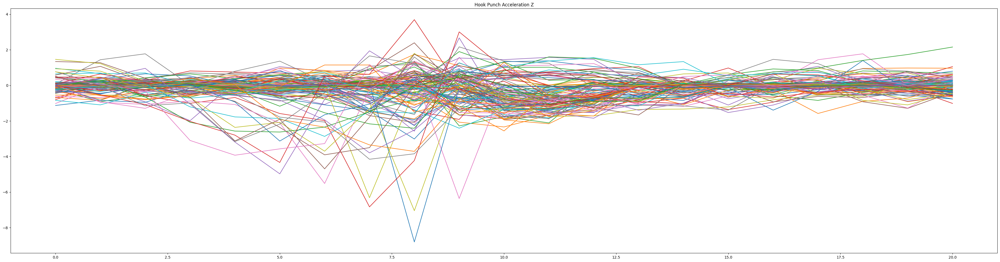

In [ ]:
plt.figure(figsize=(48, 12))
plt.title('Hook Punch Acceleration X')
for i in punch_datas['Hook']:
  plt.plot(i.index, i['Acceleration X'])

plt.figure(figsize=(48, 12))
plt.title('Hook Punch Acceleration Y')
for i in punch_datas['Hook']:
  plt.plot(i.index, i['Acceleration Y'])

plt.figure(figsize=(48, 12))
plt.title('Hook Punch Acceleration Z')
for i in punch_datas['Hook']:
  plt.plot(i.index, i['Acceleration Z'])

plt.show()

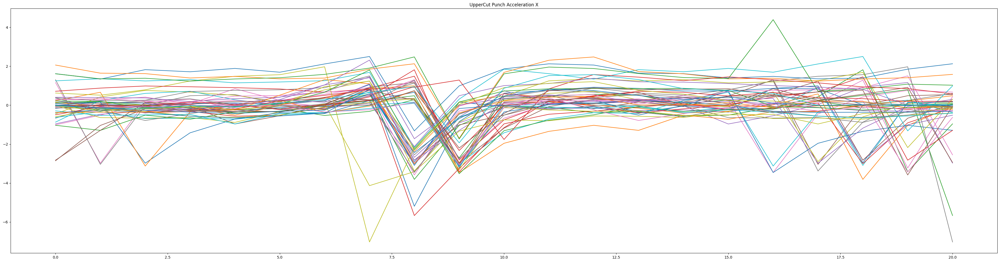

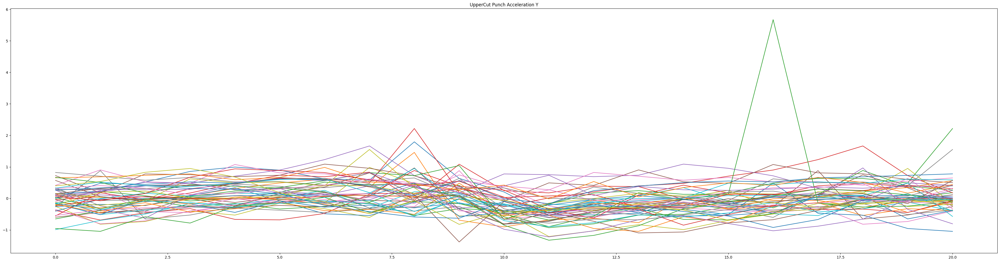

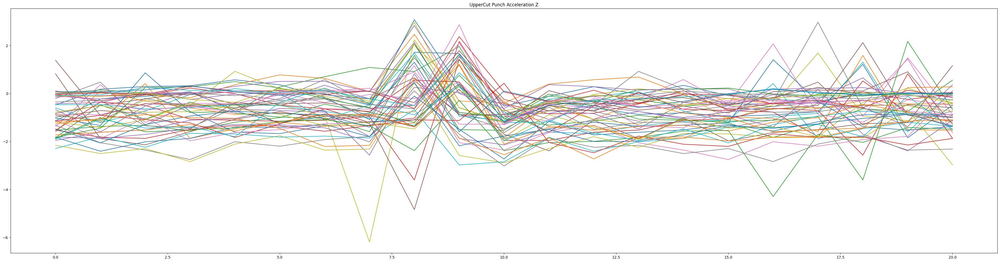

In [ ]:
plt.figure(figsize=(48, 12))
plt.title('UpperCut Punch Acceleration X')
for i in punch_datas['UpperCut']:
  plt.plot(i.index, i['Acceleration X'])

plt.figure(figsize=(48, 12))
plt.title('UpperCut Punch Acceleration Y')
for i in punch_datas['UpperCut']:
  plt.plot(i.index, i['Acceleration Y'])

plt.figure(figsize=(48, 12))
plt.title('UpperCut Punch Acceleration Z')
for i in punch_datas['UpperCut']:
  plt.plot(i.index, i['Acceleration Z'])

plt.show()

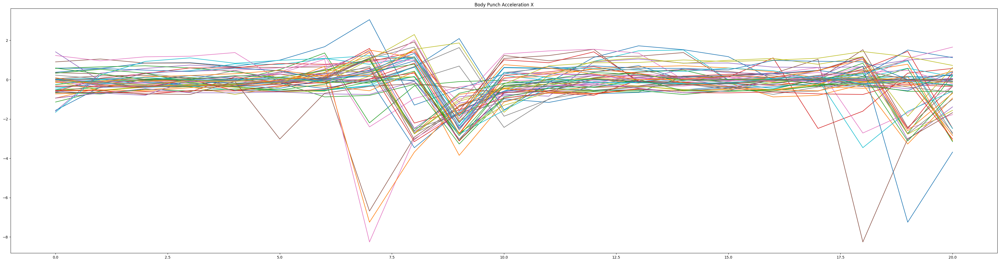

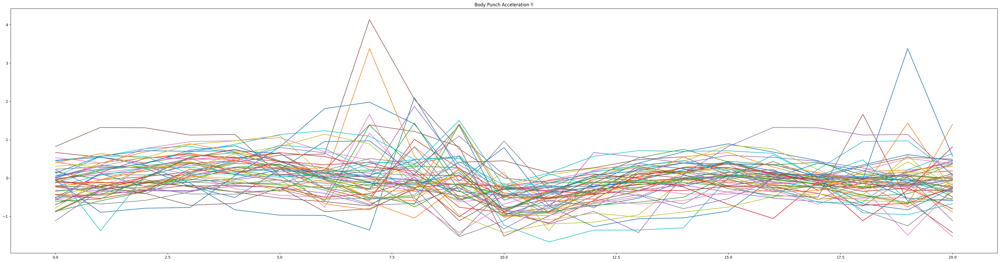

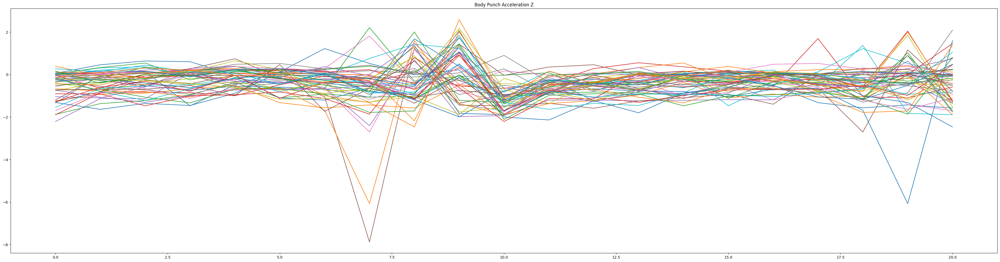

In [ ]:
plt.figure(figsize=(48, 12))
plt.title('Body Punch Acceleration X')
for i in punch_datas['Body']:
  plt.plot(i.index, i['Acceleration X'])

plt.figure(figsize=(48, 12))
plt.title('Body Punch Acceleration Y')
for i in punch_datas['Body']:
  plt.plot(i.index, i['Acceleration Y'])

plt.figure(figsize=(48, 12))
plt.title('Body Punch Acceleration Z')
for i in punch_datas['Body']:
  plt.plot(i.index, i['Acceleration Z'])

plt.show()

이제 정규화한 데이터들의 분포를 살펴보겠다.

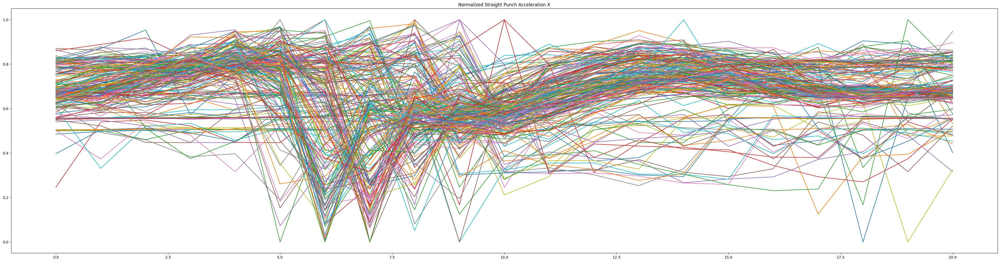

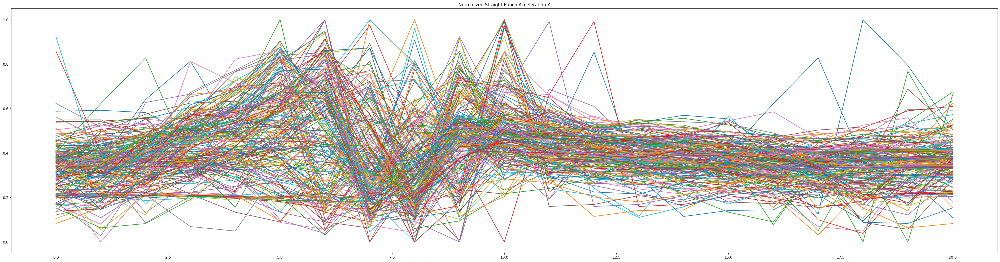

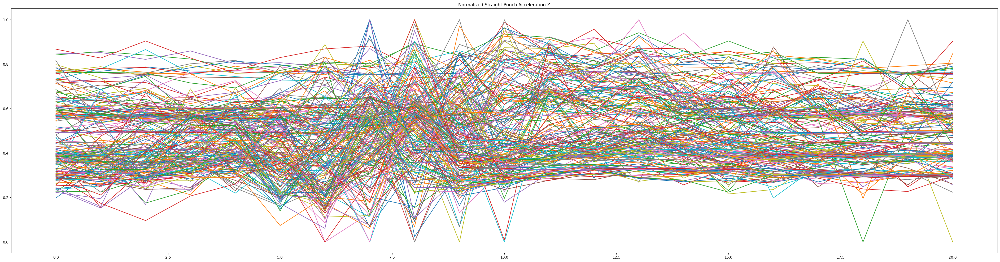

In [ ]:
plt.figure(figsize=(48, 12))
plt.title('Normalized Straight Punch Acceleration X')
for i in normalized_punch_datas['Straight']:
  plt.plot(i.index, i['Acceleration X'])

plt.figure(figsize=(48, 12))
plt.title('Normalized Straight Punch Acceleration Y')
for i in normalized_punch_datas['Straight']:
  plt.plot(i.index, i['Acceleration Y'])

plt.figure(figsize=(48, 12))
plt.title('Normalized Straight Punch Acceleration Z')
for i in normalized_punch_datas['Straight']:
  plt.plot(i.index, i['Acceleration Z'])

plt.show()

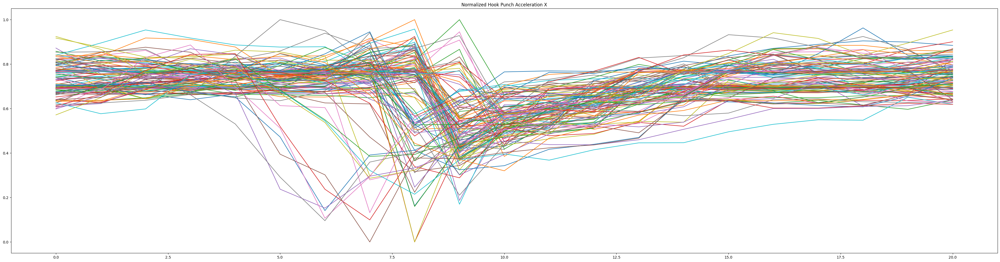

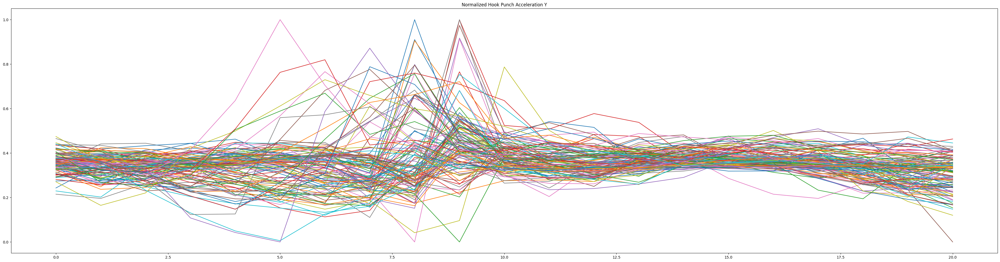

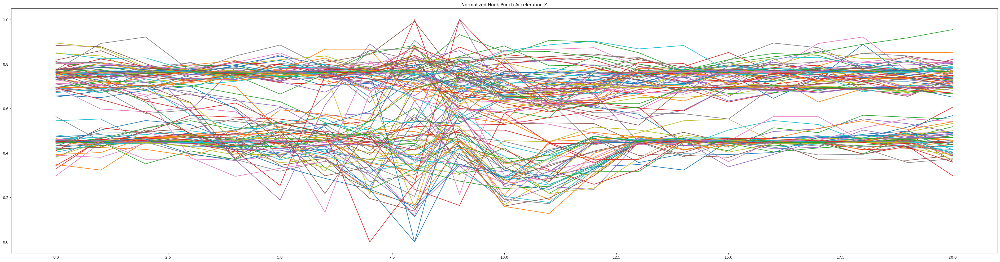

In [ ]:
plt.figure(figsize=(48, 12))
plt.title('Normalized Hook Punch Acceleration X')
for i in normalized_punch_datas['Hook']:
  plt.plot(i.index, i['Acceleration X'])

plt.figure(figsize=(48, 12))
plt.title('Normalized Hook Punch Acceleration Y')
for i in normalized_punch_datas['Hook']:
  plt.plot(i.index, i['Acceleration Y'])

plt.figure(figsize=(48, 12))
plt.title('Normalized Hook Punch Acceleration Z')
for i in normalized_punch_datas['Hook']:
  plt.plot(i.index, i['Acceleration Z'])

plt.show()

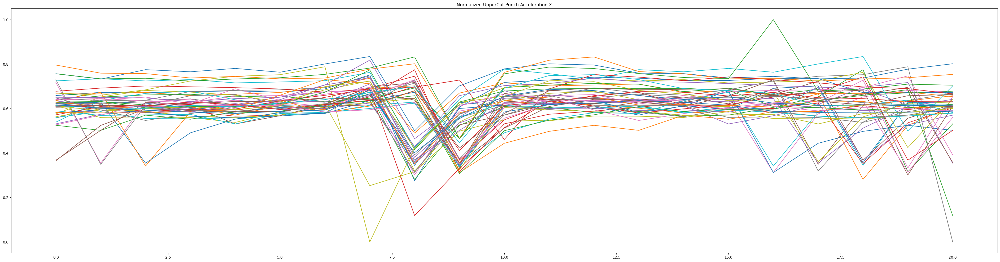

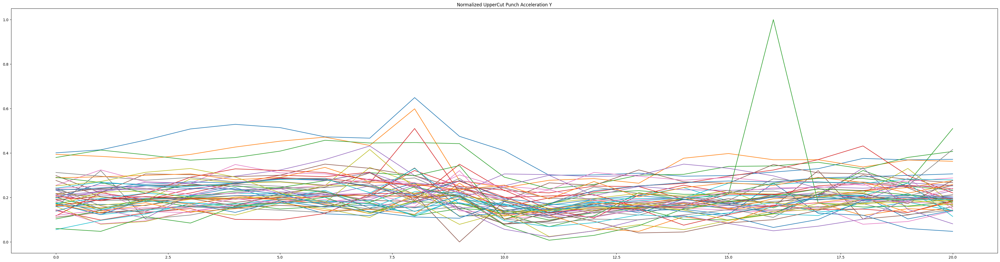

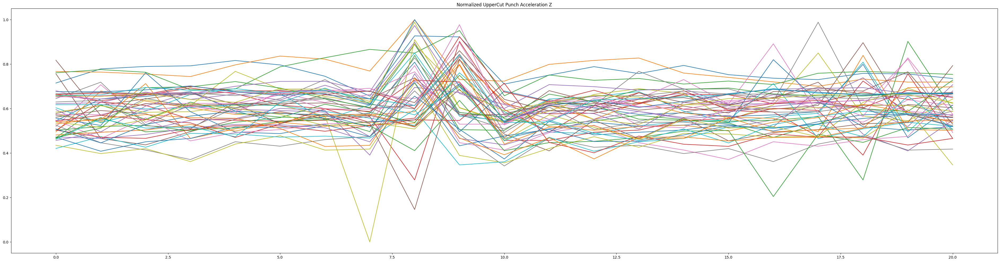

In [ ]:
plt.figure(figsize=(48, 12))
plt.title('Normalized UpperCut Punch Acceleration X')
for i in normalized_punch_datas['UpperCut']:
  plt.plot(i.index, i['Acceleration X'])

plt.figure(figsize=(48, 12))
plt.title('Normalized UpperCut Punch Acceleration Y')
for i in normalized_punch_datas['UpperCut']:
  plt.plot(i.index, i['Acceleration Y'])

plt.figure(figsize=(48, 12))
plt.title('Normalized UpperCut Punch Acceleration Z')
for i in normalized_punch_datas['UpperCut']:
  plt.plot(i.index, i['Acceleration Z'])

plt.show()

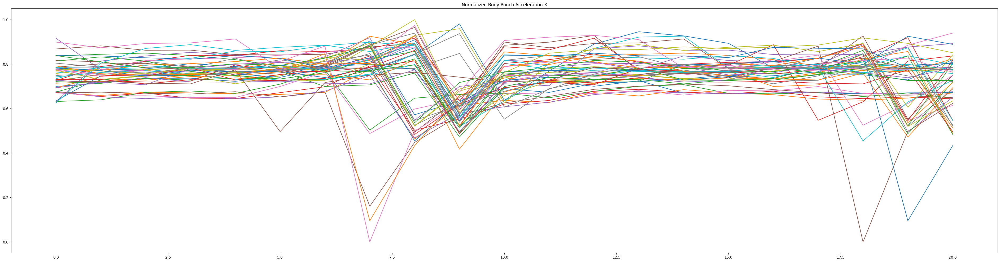

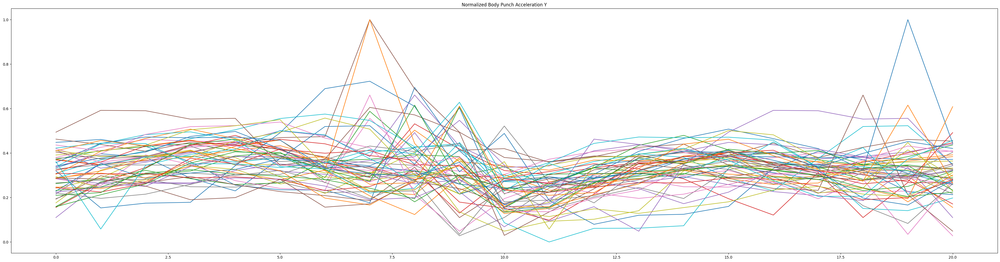

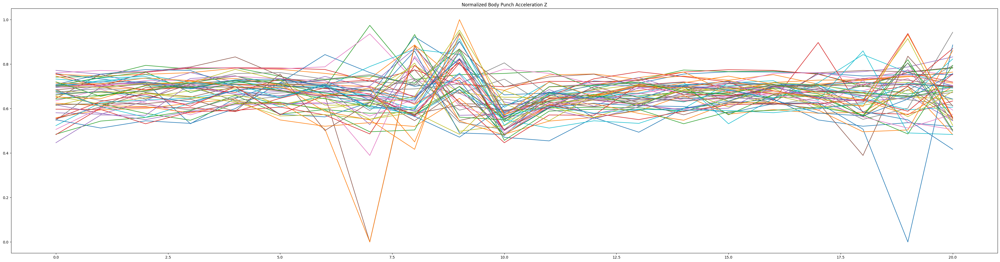

In [ ]:
plt.figure(figsize=(48, 12))
plt.title('Normalized Body Punch Acceleration X')
for i in normalized_punch_datas['Body']:
  plt.plot(i.index, i['Acceleration X'])

plt.figure(figsize=(48, 12))
plt.title('Normalized Body Punch Acceleration Y')
for i in normalized_punch_datas['Body']:
  plt.plot(i.index, i['Acceleration Y'])

plt.figure(figsize=(48, 12))
plt.title('Normalized Body Punch Acceleration Z')
for i in normalized_punch_datas['Body']:
  plt.plot(i.index, i['Acceleration Z'])

plt.show()

### 8. 데이터 분석

ACF로 데이터의 정상성을 확인한다.

In [ ]:
import warnings
from statsmodels.tsa.stattools import acf
from statsmodels.tsa.ar_model import AutoReg

warnings.filterwarnings('ignore', category=FutureWarning)

acf_results = {}
ar_coeffs = {}

for punch_type, dataframes in punch_datas.items():
  acf_results[punch_type] = []
  ar_coeffs[punch_type] = []
  for df in dataframes:
    acf_x = acf(df['Acceleration X'], fft=True)
    acf_y = acf(df['Acceleration Y'], fft=True)
    acf_z = acf(df['Acceleration Z'], fft=True)
    acf_results[punch_type].append((acf_x, acf_y, acf_z))

    try:
        model_x = AutoReg(df['Acceleration X'], lags=1)
        model_x_fit = model_x.fit()
        ar_x = model_x_fit.params[1]

        model_y = AutoReg(df['Acceleration Y'], lags=1)
        model_y_fit = model_y.fit()
        ar_y = model_y_fit.params[1]

        model_z = AutoReg(df['Acceleration Z'], lags=1)
        model_z_fit = model_z.fit()
        ar_z = model_z_fit.params[1]

        ar_coeffs[punch_type].append((ar_x, ar_y, ar_z))
    except:
        # Handle cases where AR model fitting might fail (e.g., insufficient data)
        ar_coeffs[punch_type].append((None, None, None))

print("ACF Results:")
for punch_type, results in acf_results.items():
    print(f"{punch_type}: {len(results)} sets of ACF values")



print("\nAR Coefficients:")
for punch_type, coeffs in ar_coeffs.items():
    print(f"{punch_type}: {len(coeffs)} sets of AR(1) coefficients")

ACF Results:
Straight: 217 sets of ACF values
Hook: 118 sets of ACF values
UpperCut: 51 sets of ACF values
Body: 53 sets of ACF values

AR Coefficients:
Straight: 217 sets of AR(1) coefficients
Hook: 118 sets of AR(1) coefficients
UpperCut: 51 sets of AR(1) coefficients
Body: 53 sets of AR(1) coefficients


In [ ]:
from statsmodels.tsa.stattools import acf
import statsmodels.api as sm

stationary_counts = {punch_type: 0 for punch_type in punch_datas.keys()}
total_counts = {punch_type: 0 for punch_type in punch_datas.keys()}

for punch_type, dataframes in punch_datas.items():
    total_counts[punch_type] = len(dataframes)
    for df in dataframes:
        is_stationary = True
        for col in ['Acceleration X', 'Acceleration Y', 'Acceleration Z']:
            acf_values, conf_int, qstat, p_values = acf(df[col], fft=False, alpha=0.05, qstat=True)
            if (p_values[1:] <= 0.05).any():
                is_stationary = False
                break
        if is_stationary:
            stationary_counts[punch_type] += 1

print("Stationarity Analysis")
for punch_type in punch_datas.keys():
    stationary_proportion = stationary_counts[punch_type] / total_counts[punch_type] if total_counts[punch_type] > 0 else 0
    non_stationary_proportion = 1 - stationary_proportion
    print(f"{punch_type}:")
    print(f"  정상성 비율: {stationary_proportion:.2f}")
    print(f"  비정상성 비율: {non_stationary_proportion:.2f}")

Stationarity Analysis
Straight:
  정상성 비율: 0.30
  비정상성 비율: 0.70
Hook:
  정상성 비율: 0.10
  비정상성 비율: 0.90
UpperCut:
  정상성 비율: 0.37
  비정상성 비율: 0.63
Body:
  정상성 비율: 0.34
  비정상성 비율: 0.66


In [ ]:
differenced_stationary_counts = {punch_type: 0 for punch_type in punch_datas.keys()}
differenced_total_counts = {punch_type: 0 for punch_type in punch_datas.keys()}

for punch_type, dataframes in punch_datas.items():
    non_stationary_dataframes = []
    for i, df in enumerate(dataframes):
        is_stationary = True
        for col in ['Acceleration X', 'Acceleration Y', 'Acceleration Z']:
            acf_values, conf_int, qstat, p_values = acf(df[col], fft=False, alpha=0.05, qstat=True)
            if (p_values[1:] <= 0.05).any():
                is_stationary = False
                break
        if not is_stationary:
            non_stationary_dataframes.append(df.copy())

    differenced_total_counts[punch_type] = len(non_stationary_dataframes)

    for df in non_stationary_dataframes:
        df['Acceleration X Diff'] = df['Acceleration X'].diff().dropna()
        df['Acceleration Y Diff'] = df['Acceleration Y'].diff().dropna()
        df['Acceleration Z Diff'] = df['Acceleration Z'].diff().dropna()

        is_stationary_differenced = True
        for col in ['Acceleration X Diff', 'Acceleration Y Diff', 'Acceleration Z Diff']:
            if len(df[col]) > 1:
                acf_values, conf_int, qstat, p_values = acf(df[col], fft=False, alpha=0.05, qstat=True)
                if (p_values[1:] <= 0.05).any():
                    is_stationary_differenced = False
                    break
            else:
                 is_stationary_differenced = False

        if is_stationary_differenced:
            differenced_stationary_counts[punch_type] += 1

print("\nStationarity Analysis (차분)")
for punch_type in punch_datas.keys():
    stationary_proportion_differenced = differenced_stationary_counts[punch_type] / differenced_total_counts[punch_type] if differenced_total_counts[punch_type] > 0 else 0
    non_stationary_proportion_differenced = 1 - stationary_proportion_differenced
    print(f"{punch_type}:")
    print(f"  정상성 비율: {stationary_proportion_differenced:.2f}")
    print(f"  비정상성 비율: {non_stationary_proportion_differenced:.2f}")


Stationarity Analysis (차분)
Straight:
  정상성 비율: 1.00
  비정상성 비율: 0.00
Hook:
  정상성 비율: 1.00
  비정상성 비율: 0.00
UpperCut:
  정상성 비율: 1.00
  비정상성 비율: 0.00
Body:
  정상성 비율: 1.00
  비정상성 비율: 0.00


데이터를 차분하여 정상성을 확보할 수 있음을 알게 되었다. 하지만 워낙 데이터의 길이가 짧아 유의미한 값은 아니라고 본다.


In [ ]:
def global_similarity_test(X, B=1000, seed=None, threshold=0.5):
    """
    X: numpy array, shape (n_series, length)
    B: permutation 반복 횟수 (예: 1000)
    threshold: '강한 유사성' 판정에 쓸 상관 임계값 (옵션)
    반환: dict (관측 평균 상관, p-value, 강한 유사성 비율 등)
    """
    rng = np.random.RandomState(seed)
    n, L = X.shape

    # 1) 시계열별 Z-score 정규화 (패턴 비교 목적)
    Xz = (X - X.mean(axis=1, keepdims=True)) / X.std(axis=1, keepdims=True)

    # 2) 모든 쌍의 피어슨 상관계수
    corrmat = np.corrcoef(Xz)            # shape (n, n)
    iu = np.triu_indices(n, k=1)
    pair_corrs = corrmat[iu]             # 길이 n*(n-1)/2

    observed_mean = pair_corrs.mean()
    observed_median = np.median(pair_corrs)
    frac_strong = np.mean(pair_corrs > threshold)

    # 3) permutation null distribution (각 시계열의 시간축을 독립적으로 섞음)
    null_means = np.empty(B)
    for b in range(B):
        permuted = np.array([rng.permutation(row) for row in Xz])
        c = np.corrcoef(permuted)
        null_means[b] = c[iu].mean()

    # one-sided p-value: 관측 평균이 null보다 큰가?
    pvalue = (np.sum(null_means >= observed_mean) + 1) / (B + 1)

    return pvalue

각 시계열을 표준화(Z-score) 해서 모양(패턴)만 비교한다.

모든 시계열 쌍의 상관계수(또는 다른 유사도) 를 구해 평균/중앙값/분포를 본다.

Permutation test로 그 평균(또는 다른 요약통계)이 우연히 커질 수 있는지 검정한다.

귀무가설: “시계열 간에 공통 패턴 없음” → 각 시계열의 시간축을 무작위 섞어(또는 크게 어긋나게 해서) 유사성이 사라진 경우의 분포를 만든다.

관측값이 (예: 평균 상관계수) 이 분포의 극단에 있으면 전체적으로 유사성이 있다고 판단.

In [ ]:
for punch_type, dataframes in punch_datas.items():
  X_x = []
  X_y = []
  X_z = []

  for i in dataframes:
    a = i['Acceleration X'].to_list()
    if len(a) == 21:
      X_x.append(a)

    b = i['Acceleration Y'].to_list()
    if len(b) == 21:
      X_y.append(b)

    c = i['Acceleration Z'].to_list()
    if len(c) == 21:
      X_z.append(c)

  X_x = np.array(X_x)
  X_y = np.array(X_y)
  X_z = np.array(X_z)

  if global_similarity_test(X_x) < 0.05:
    print(f"X 축 {punch_type} 데이터는 유사성을 가진다.")
  else:
    print(f"X 축 {punch_type} 데이터는 유사성을 가지지 않는다.")

  if global_similarity_test(X_y) < 0.05:
    print(f"Y 축 {punch_type} 데이터는 유사성을 가진다.")
  else:
    print(f"Y 축 {punch_type} 데이터는 유사성을 가지지 않는다.")

  if global_similarity_test(X_z) < 0.05:
    print(f"Z 축 {punch_type} 데이터는 유사성을 가진다.")
  else:
    print(f"Z 축 {punch_type} 데이터는 유사성을 가지지 않는다.")

  print()

X 축 Straight 데이터는 유사성을 가진다.
Y 축 Straight 데이터는 유사성을 가진다.
Z 축 Straight 데이터는 유사성을 가진다.

X 축 Hook 데이터는 유사성을 가진다.
Y 축 Hook 데이터는 유사성을 가진다.
Z 축 Hook 데이터는 유사성을 가진다.

X 축 UpperCut 데이터는 유사성을 가진다.
Y 축 UpperCut 데이터는 유사성을 가진다.
Z 축 UpperCut 데이터는 유사성을 가진다.

X 축 Body 데이터는 유사성을 가진다.
Y 축 Body 데이터는 유사성을 가진다.
Z 축 Body 데이터는 유사성을 가진다.



### 9. 데이터 분석의 결론

위 데이터의 피어슨 상관계수를 분석한 결과 각 주먹 데이터의 가속도 값은 각각 특정 패턴을 가지는 것으로 분석되었다. 또, 시각화된 자료를 분석한 결과 Straight 주먹의 경우 X 가속도 값이 음수인 극소값을 가지는 특정 패턴을 이루는 것을 알 수 있었다. 또 Y축 또한 양수의 극대 값을 가지는 것을 알 수 있었고, Z축은 0 부근에 존재하는 것을 알 수 있었다. 이는 Straight 주먹이 주로 X축과 Y축 가속도 데이터의 변화에 영향을 받는 다는 것을 알려주었다. 같은 방식으로, 나머지 Hook, UppeCut, Body 데이터를 분석할 경우 UpperCut X와 Z, Hook과 Body는 모든 축의 가속도 값에 영향을 받는다는 것을 알 수 있었다. 이 관측된 사실은 실제 복싱에서 주먹이 향하는 방향과 가해지는 힘과 유사함을 알 수 있다.


### 10. 추후 계획 및 가능성

이 연구를 바탕으로 사용자의 주먹을 인식하는 딥러닝 모델을 더욱 정확히 구축하거나, 딥러닝 모델 없이 통계적 특징으로 주먹을 분류하는 모델을 개발할 수 있다. 따라서 추후에 각 주먹을 인식하는 GRU(Gate Recurrent Unit, 게이트 순환 유닛)모델을 활용하여 각 주먹의 패턴을 인식하는 딥러닝 모델을 개발할 것이다. 위에서 보여진 바로 의하면 각 주먹에 해당하는 X, Y, Z축은 모두 고유한 패턴을 가지고 있었으므로, 충분하고 정확도 높은 데이터셋을 준비한다면 자원을 덜쓰며 빠르게 주먹을 인식하는 모델을 개발할 수 있다.